In [183]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import statsmodels.api as sm
from statsmodels.tsa.stattools import acf
from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.arima.model import ARIMA
from datetime import timedelta

import seaborn as sns
from scipy.stats import norm
import datetime

import warnings
warnings.filterwarnings("ignore")

In [184]:
Dgaz=pd.read_excel('./dgaz.xlsx', usecols=(1,2,3))  #ne garde que les colonnes qui nous interessent
Dgaz=Dgaz.dropna()#se debarasse des valeurs manquantes

Dtest=pd.DataFrame(Dgaz[Dgaz.Date.str.contains('2023')]) #Janvier 2023 à aout 2023
Dtest

,Date,Heure,Consommation brute gaz totale (MW PCS 0°C)
1,31/08/2023,23:00,24713.0
3,31/08/2023,22:00,26116.0
5,31/08/2023,21:00,27681.0
7,31/08/2023,20:00,28909.0
9,31/08/2023,19:00,29337.0
...,...,...,...
11655,01/01/2023,04:00,38482.0
11657,01/01/2023,03:00,35818.0
11659,01/01/2023,02:00,34675.0
11661,01/01/2023,01:00,34234.0


In [185]:
#Pour garder que les données de 2012 à 2022
(n,p)=Dtest.shape
NW_dG = Dgaz.drop(Dgaz.index[0:n]) #SUPPRIME LES DONNEES 2023
NW_dG

,Date,Heure,Consommation brute gaz totale (MW PCS 0°C)
13153,30/11/2022,23:00,65613.0
13155,30/11/2022,22:00,70834.0
13157,30/11/2022,21:00,76848.0
13159,30/11/2022,20:00,81313.0
13161,30/11/2022,19:00,84104.0
...,...,...,...
204519,01/01/2012,04:00,57082.0
204521,01/01/2012,03:00,56048.0
204523,01/01/2012,02:00,55465.0
204525,01/01/2012,01:00,55444.0


In [186]:
#consommation par jours de 2012 à fin 2022

NW_dG['Date'] = pd.to_datetime(NW_dG['Date'])
Dgj = pd.DataFrame(NW_dG.groupby(NW_dG['Date'].dt.date)['Consommation brute gaz totale (MW PCS 0°C)'].sum())
Dgj = Dgj.reset_index()
Dgj

,Date,Consommation brute gaz totale (MW PCS 0°C)
0,2012-01-01,1446815.0
1,2012-01-02,1791945.0
2,2012-01-03,2005753.0
3,2012-01-04,1997598.0
4,2012-01-05,2038430.0
...,...,...
3982,2022-11-26,1520656.0
3983,2022-11-27,1365501.0
3984,2022-11-28,1660871.0
3985,2022-11-29,1832377.0


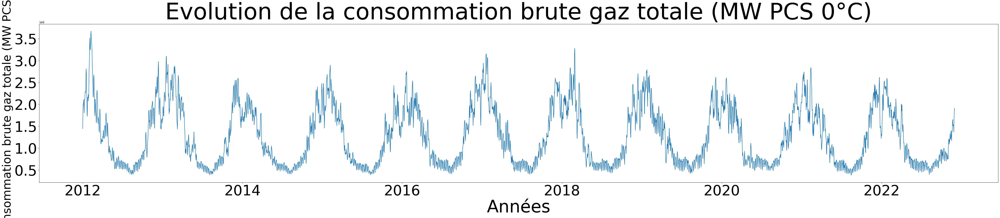

In [187]:
## Graph : évolution de la consommation de gaz par jour
plt.figure(figsize=(60,10))
plt.plot(Dgj['Date'], Dgj['Consommation brute gaz totale (MW PCS 0°C)'])
plt.title('Evolution de la consommation brute gaz totale (MW PCS 0°C)', fontsize = 80)
plt.xlabel('Années', fontsize =60)
plt.ylabel('Consommation brute gaz totale (MW PCS 0°C)', fontsize = 40)
plt.xticks(fontsize=50)
plt.yticks(fontsize=50)
#plt.xlim(pd.Timestamp('2012-01-03'), pd.Timestamp('2014-12-31'))

plt.show()

# gestion de la non stationnarité

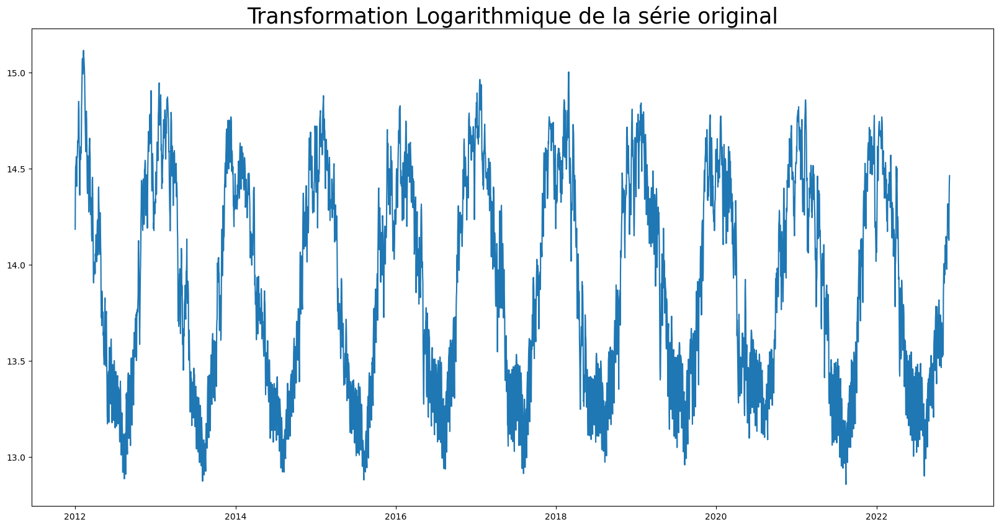

In [188]:
### passage au log de la série brute 

Dgj_log = Dgj.copy()
Dgj_log['Consommation brute gaz totale (MW PCS 0°C)'] = np.log(Dgj_log['Consommation brute gaz totale (MW PCS 0°C)'])

plt.figure(figsize=(20 , 10))
plt.plot(Dgj_log['Date'], Dgj_log['Consommation brute gaz totale (MW PCS 0°C)'])
#plt.xlim(pd.Timestamp('2013-08-01'), pd.Timestamp('2020-01-31'))

plt.title('Transformation Logarithmique de la série original', fontsize =25)

plt.show()

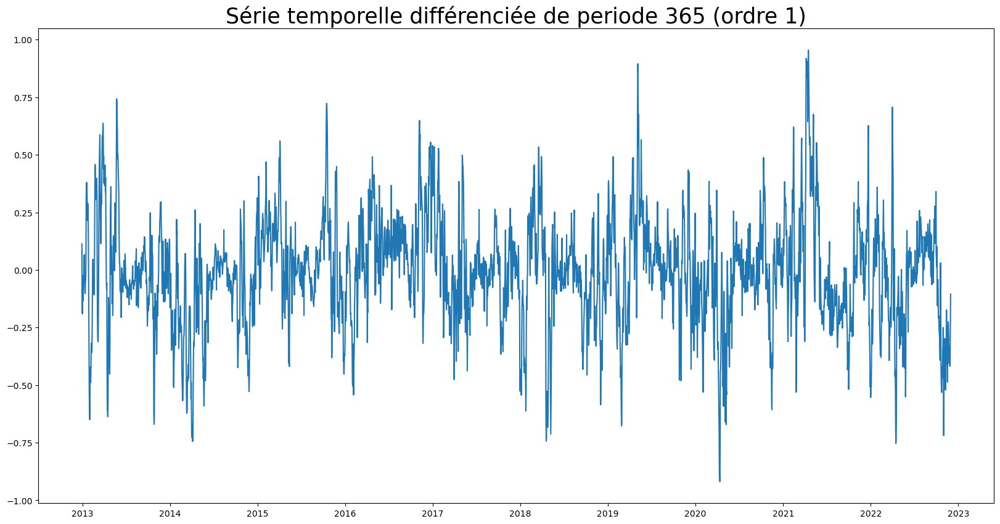

In [189]:
##### Différenciation 1, période de 1 an

diff1_Dgj_log = Dgj_log.copy()
diff1_Dgj_log ['Consommation brute gaz totale (MW PCS 0°C)'] = diff1_Dgj_log['Consommation brute gaz totale (MW PCS 0°C)'].diff(periods=364).dropna()

# Tracer la série temporelle différenciée
plt.figure(figsize=(20 , 10))
plt.plot(diff1_Dgj_log['Date'], diff1_Dgj_log['Consommation brute gaz totale (MW PCS 0°C)'])
#plt.xlim(pd.Timestamp('2014-08-01'), pd.Timestamp('2017-01-31'))

plt.title('Série temporelle différenciée de periode 365 (ordre 1)', fontsize=25)
plt.show()

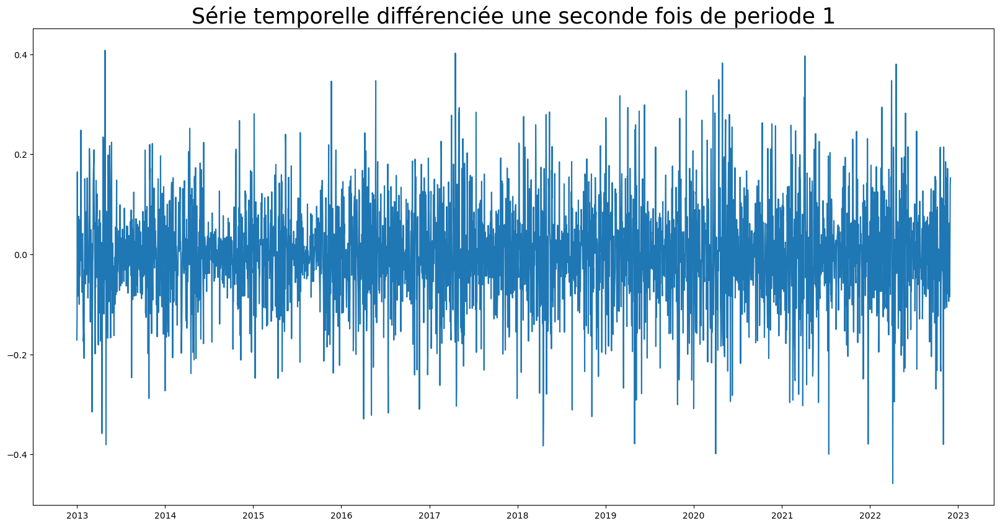

In [190]:
##### Différenciation 1, période de 1 jour

diff2_Dgj_log = diff1_Dgj_log.copy()
diff2_Dgj_log ['Consommation brute gaz totale (MW PCS 0°C)'] = diff2_Dgj_log['Consommation brute gaz totale (MW PCS 0°C)'].diff(periods=1).dropna()

# Tracer la série temporelle différenciée
plt.figure(figsize=(20 , 10))
plt.plot(diff2_Dgj_log['Date'], diff2_Dgj_log['Consommation brute gaz totale (MW PCS 0°C)'])
#plt.xlim(pd.Timestamp('2014-08-01'), pd.Timestamp('2017-01-31'))

plt.title( label='Série temporelle différenciée une seconde fois de periode 1', fontsize=25)
plt.show()

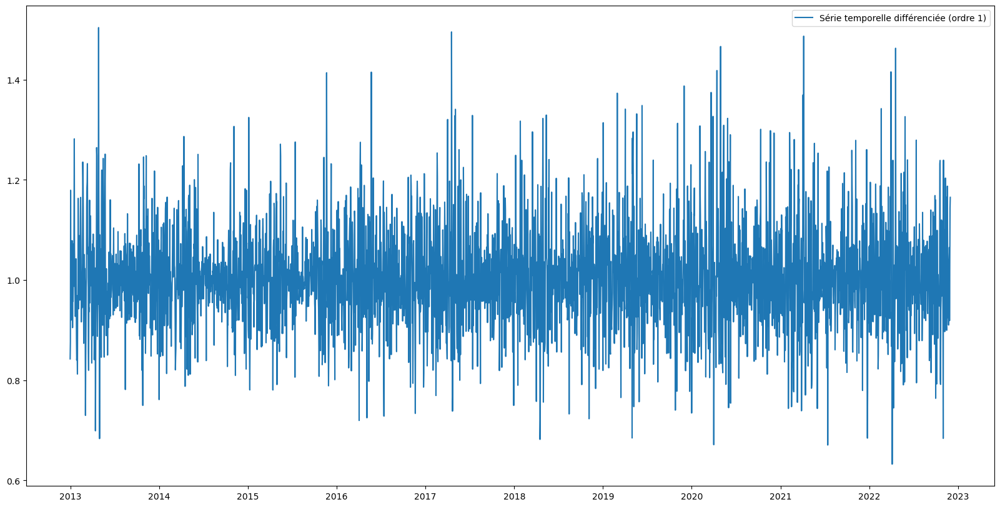

In [191]:
#### Passage de la série à l'exponentielle (jsp s'il faut le faire)
diff2_Dgj_exp = diff2_Dgj_log.copy()
diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'] = np.exp (diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'])

plt.figure(figsize=(20 , 10))
plt.plot(diff2_Dgj_exp['Date'], diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'], label='Série temporelle différenciée (ordre 1)')
#plt.xlim(pd.Timestamp('2014-08-01'), pd.Timestamp('2017-01-31'))

plt.legend()
plt.show()

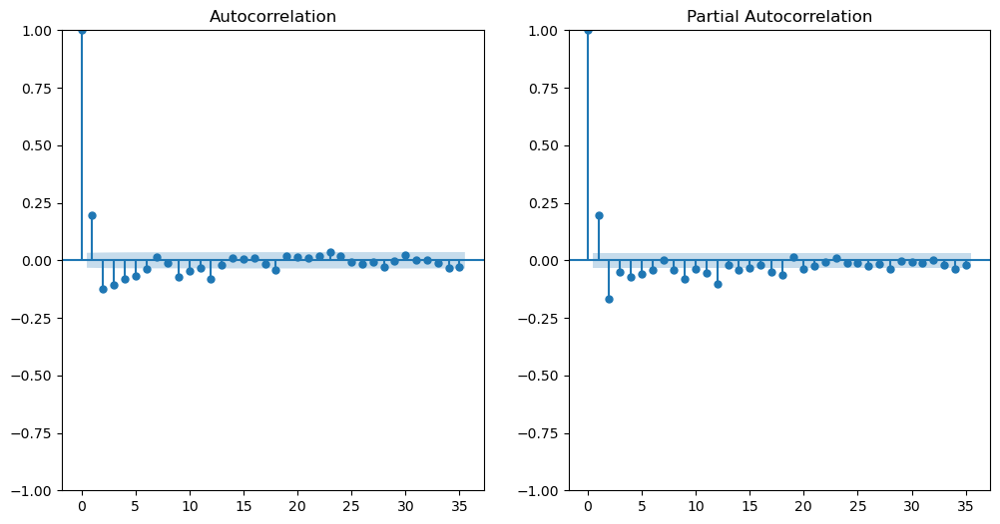

In [192]:
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

#CALCUL DU PACF ET DU ACF
plt.figure(figsize=(12, 6))

plt.subplot(121)
plot_acf(diff2_Dgj_exp ['Consommation brute gaz totale (MW PCS 0°C)'].dropna(), ax=plt.gca(), lags=35)

plt.subplot(122)
plot_pacf(diff2_Dgj_exp ['Consommation brute gaz totale (MW PCS 0°C)'].dropna(), ax=plt.gca(), lags=35)

plt.show()

In [193]:
import pandas as pd
from statsmodels.tsa.stattools import adfuller

# Supposons que 'serie_temporelle' soit votre série temporelle avec des dates comme index
# Assurez-vous que la colonne de dates est utilisée comme index du DataFrame
# serie_temporelle.set_index('date', inplace=True)

# Remplacez 'Votre_colonne' par le nom de la colonne de votre série temporelle
y = diff2_Dgj_exp ['Consommation brute gaz totale (MW PCS 0°C)'].dropna()

# Effectuer le test ADF
resultats_adf = adfuller(y)

# Afficher les résultats
print('Statistique ADF :', resultats_adf[0])
print('P-valeur :', resultats_adf[1])
print('Nombre de retards utilisés :', resultats_adf[2])
print('Nombre d\'observations utilisées :', resultats_adf[3])
print('Valeurs critiques :', resultats_adf[4])

# Interprétation des résultats
if resultats_adf[1] <= 0.05:
    print('La série temporelle semble stationnaire (rejeter l\'hypothèse nulle)')
else:
    print('La série temporelle ne semble pas stationnaire (échec de rejeter l\'hypothèse nulle)')


Statistique ADF : -19.11842148749368
P-valeur : 0.0
Nombre de retards utilisés : 19
Nombre d'observations utilisées : 3602
Valeurs critiques : {'1%': -3.432166759109125, '5%': -2.862342742516423, '10%': -2.567197312560947}
La série temporelle semble stationnaire (rejeter l'hypothèse nulle)


# modele MA 12

                                           SARIMAX Results                                            
Dep. Variable:     Consommation brute gaz totale (MW PCS 0°C)   No. Observations:                 3189
Model:                                        ARIMA(0, 0, 12)   Log Likelihood                2752.358
Date:                                        Sun, 17 Dec 2023   AIC                          -5476.716
Time:                                                09:41:49   BIC                          -5391.772
Sample:                                                     0   HQIC                         -5446.256
                                                       - 3189                                         
Covariance Type:                                          opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.0

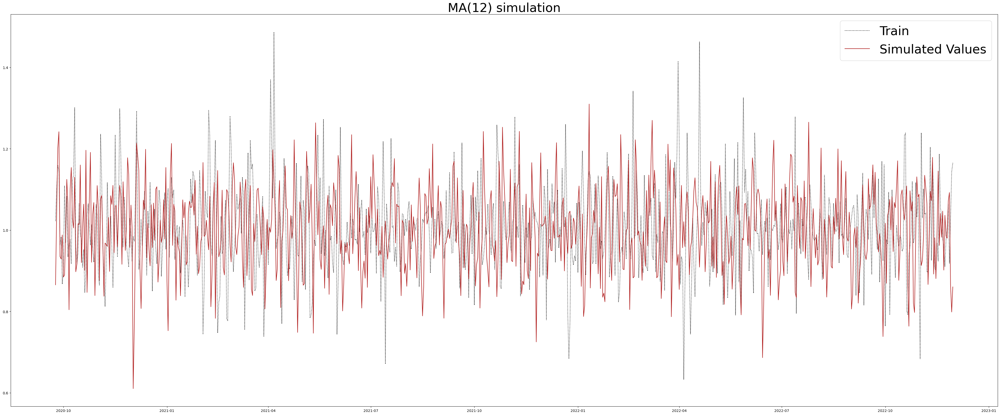

RMSE: 0.14516772179522128
MAE: 0.11418535805476782


In [194]:
###### MA(12)

import statsmodels.api as sm
import matplotlib.pyplot as plt

# Spécifie l'ordre MA à 12
order = (0, 0, 12)

# Remplacez par votre propre série temporelle
data = diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)']

# Séparer les données en ensembles d'entraînement (80%) et de test (20%)
train_size_ma12 = int(len(data) * 0.8)
train_ma12, test_ma12 = data[:train_size_ma12], data[train_size_ma12:]

# Entraîner le modèle MA sur les données d'entraînement
model = sm.tsa.ARIMA(train_ma12, order=order)
result = model.fit()

# Afficher les résultats du modèle
print(result.summary())

# Simuler les valeurs pour les données de test
simulated_values_ma12 = result.simulate(steps=len(test_ma12), nsimulations=len(test_ma12))

# Ajuster les index des valeurs simulées pour les faire correspondre aux données de test
simulated_values_ma12.index += len(train_ma12)

# Tracer les résultats
plt.figure(figsize=(50,20))
plt.plot(diff2_Dgj_exp ['Date'][train_size_ma12:], test_ma12, label='Train', linestyle='dotted', color='black')
plt.plot(diff2_Dgj_exp ['Date'][train_size_ma12:], simulated_values_ma12, label='Simulated Values', color='firebrick')
plt.legend(fontsize=35)
plt.title('MA(12) simulation', fontsize =35)
plt.show()

##############

from sklearn.metrics import mean_squared_error, mean_absolute_error

# Calculer les prédictions sur les données de test
predictions = simulated_values_ma12

# Calculer l'erreur quadratique moyenne (RMSE)
rmse = np.sqrt(mean_squared_error(test_ma12, predictions))

# Calculer l'erreur absolue moyenne (MAE)
mae = mean_absolute_error(test_ma12, predictions)

print(f'RMSE: {rmse}')
print(f'MAE: {mae}')



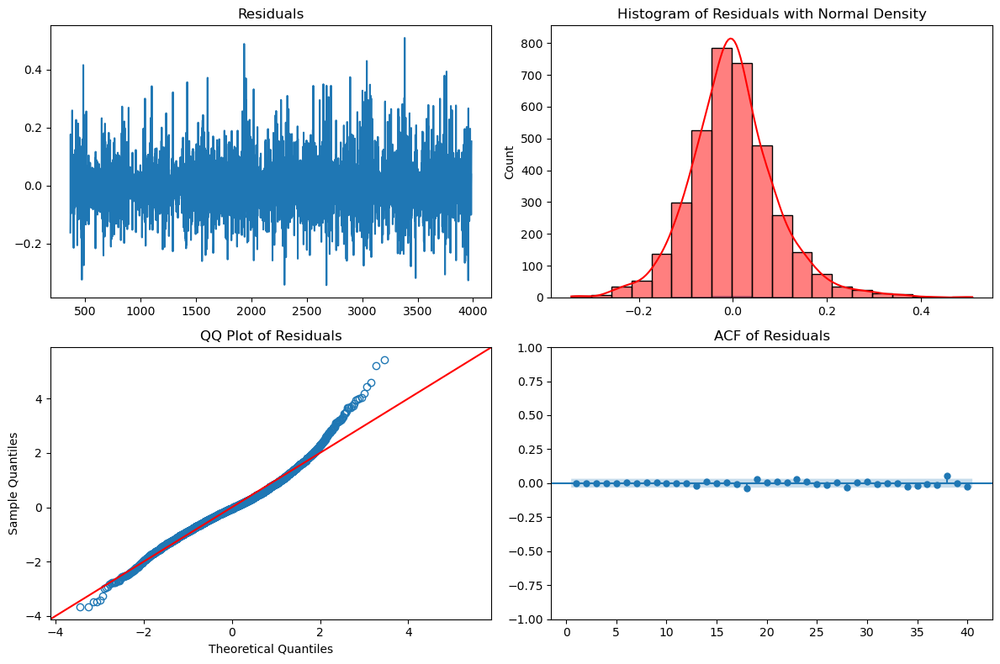

In [195]:
import seaborn as sns
from scipy.stats import norm

model = ARIMA(diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'], order=(0,0,12))
ARMA_res = model.fit()

# Extraire les résidus du modèle ARIMA
arima_residuals_ma_12 = ARMA_res.resid

# Visualiser les diagnostics personnalisés
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Graphique des résidus
axes[0, 0].plot(arima_residuals_ma_12)
axes[0, 0].set_title('Residuals')

# Histogramme des résidus
axes[0, 1].hist(arima_residuals_ma_12, bins=20, density=True, alpha=0.7)
axes[0, 1].set_title('Histogram of Residuals')

# QQ plot des résidus
sm.qqplot(arima_residuals_ma_12.dropna(), norm,fit=True, line="45", marker='o', markerfacecolor='none',ax=axes[1, 0])
axes[1, 0].set_title('QQ Plot of Residuals')


# ACF des résidus
sm.graphics.tsa.plot_acf(arima_residuals_ma_12.dropna(), lags=40, zero=False, ax=axes[1, 1])
axes[1, 1].set_title('ACF of Residuals')

sns.histplot(arima_residuals_ma_12, bins=20, kde=True, ax=axes[0, 1], color='red')
axes[0, 1].set_title('Histogram of Residuals with Normal Density')


plt.tight_layout()
plt.show()

In [196]:
# Calcul de la statistique de test Durbin-Watson
def calculer_statistique_durbin_watson(residus):
    num = np.sum(np.diff(residus) ** 2)
    denom = np.sum(residus ** 2)
    dw = num / denom
    return dw

# Utilisation de Statsmodels pour effectuer le test de Durbin-Watson
def tester_durbin_watson(residus):
    dw_statistique = calculer_statistique_durbin_watson(residus)
    print(f"Statistique de test Durbin-Watson : {dw_statistique}")

    # Affichage d'un message interprétatif
    if dw_statistique < 1.8:
        print("Autocorrélation positive possible.")
    elif dw_statistique > 2.2:
        print("Autocorrélation négative possible.")
    else:
        print("Pas d'autocorrélation détectée.")


tester_durbin_watson(arima_residuals_ma_12.dropna())

Statistique de test Durbin-Watson : 1.9947854970988244
Pas d'autocorrélation détectée.


# Modele MA 6

                                           SARIMAX Results                                            
Dep. Variable:     Consommation brute gaz totale (MW PCS 0°C)   No. Observations:                 3189
Model:                                         ARIMA(0, 0, 6)   Log Likelihood                2723.110
Date:                                        Sun, 17 Dec 2023   AIC                          -5430.221
Time:                                                09:42:02   BIC                          -5381.681
Sample:                                                     0   HQIC                         -5412.815
                                                       - 3189                                         
Covariance Type:                                          opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.0

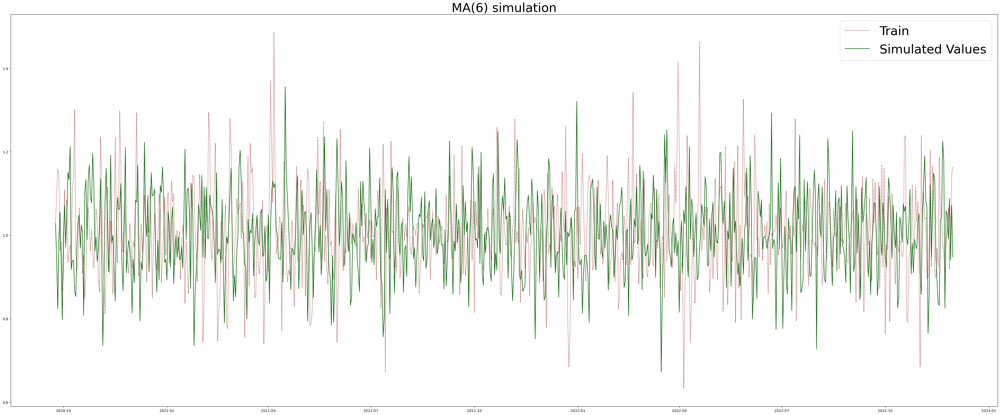

RMSE: 0.14508020873581778
MAE: 0.11531388703535954


In [197]:
###### MA(6)

import statsmodels.api as sm
import matplotlib.pyplot as plt

# Spécifie l'ordre MA à 12
order = (0, 0, 6)

# Remplacez par votre propre série temporelle
data = diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)']

# Séparer les données en ensembles d'entraînement (80%) et de test (20%)
train_size_ma6 = int(len(data) * 0.8)
train_ma6, test_ma6 = data[:train_size_ma6], data[train_size_ma6:]

# Entraîner le modèle MA sur les données d'entraînement
model = sm.tsa.ARIMA(train_ma6, order=order)
result = model.fit()

# Afficher les résultats du modèle
print(result.summary())

# Simuler les valeurs pour les données de test
simulated_values_ma6 = result.simulate(steps=len(test_ma6), nsimulations=len(test_ma6))

# Ajuster les index des valeurs simulées pour les faire correspondre aux données de test
simulated_values_ma6.index += len(train_ma6)

# Tracer les résultats
plt.figure(figsize=(50,20))
plt.plot(diff2_Dgj_exp ['Date'][train_size_ma6:], test_ma6, label='Train', linestyle='dotted', color='darkred')
plt.plot(diff2_Dgj_exp ['Date'][train_size_ma6:], simulated_values_ma6, label='Simulated Values',color='darkgreen')
plt.legend(fontsize=35)
plt.title('MA(6) simulation',fontsize=35)
plt.show()

###############

from sklearn.metrics import mean_squared_error, mean_absolute_error

# Calculer les prédictions sur les données de test
predictions = simulated_values_ma6

# Calculer l'erreur quadratique moyenne (RMSE)
rmse = np.sqrt(mean_squared_error(test_ma6, predictions))

# Calculer l'erreur absolue moyenne (MAE)
mae = mean_absolute_error(test_ma6, predictions)

print(f'RMSE: {rmse}')
print(f'MAE: {mae}')


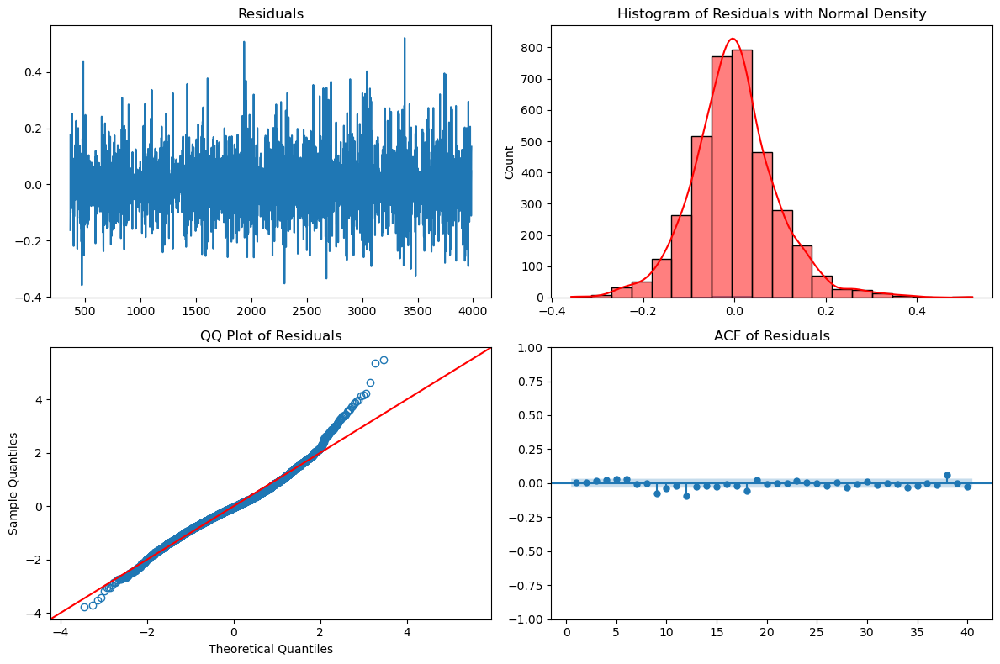

In [198]:
import seaborn as sns
from scipy.stats import norm

model = ARIMA(diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'], order=(0,0,6))
ARMA_res = model.fit()

# Extraire les résidus du modèle ARIMA
arima_residuals_ma_6= ARMA_res.resid

# Visualiser les diagnostics personnalisés
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Graphique des résidus
axes[0, 0].plot(arima_residuals_ma_6)
axes[0, 0].set_title('Residuals')

# Histogramme des résidus
axes[0, 1].hist(arima_residuals_ma_6, bins=20, density=True, alpha=0.7)
axes[0, 1].set_title('Histogram of Residuals')

# QQ plot des résidus
sm.qqplot(arima_residuals_ma_6.dropna(), norm,fit=True, line="45", marker='o', markerfacecolor='none',ax=axes[1, 0])
axes[1, 0].set_title('QQ Plot of Residuals')


# ACF des résidus
sm.graphics.tsa.plot_acf(arima_residuals_ma_6.dropna(), lags=40, zero=False, ax=axes[1, 1])
axes[1, 1].set_title('ACF of Residuals')

sns.histplot(arima_residuals_ma_6, bins=20, kde=True, ax=axes[0, 1], color='red')
axes[0, 1].set_title('Histogram of Residuals with Normal Density')


plt.tight_layout()
plt.show()

In [199]:
tester_durbin_watson(arima_residuals_ma_6.dropna())

Statistique de test Durbin-Watson : 1.9895156240760057
Pas d'autocorrélation détectée.


# Modele AR(6)

                                           SARIMAX Results                                            
Dep. Variable:     Consommation brute gaz totale (MW PCS 0°C)   No. Observations:                 3189
Model:                                         ARIMA(6, 0, 0)   Log Likelihood                2701.145
Date:                                        Sun, 17 Dec 2023   AIC                          -5386.291
Time:                                                09:42:08   BIC                          -5337.751
Sample:                                                     0   HQIC                         -5368.885
                                                       - 3189                                         
Covariance Type:                                          opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.0

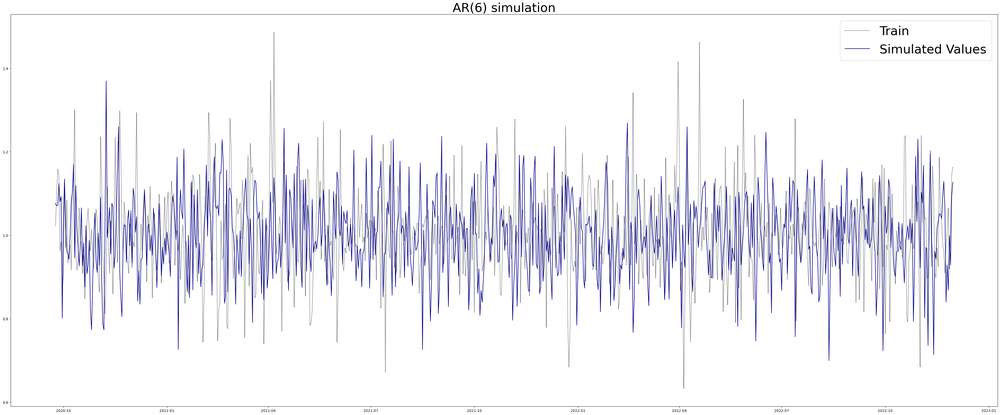

RMSE: 0.1421483771626239
MAE: 0.10982953627020188


In [200]:
###### AR(6)

import statsmodels.api as sm
import matplotlib.pyplot as plt

# Spécifie l'ordre AR à 6
order = (6, 0, 0)

# Remplacez par votre propre série temporelle
data = diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)']

# Séparer les données en ensembles d'entraînement (80%) et de test (20%)
train_size_ar6 = int(len(data) * 0.8)
train_ar6, test_ar6 = data[:train_size_ar6], data[train_size_ar6:]

# Entraîner le modèle MA sur les données d'entraînement
model = sm.tsa.ARIMA(train_ar6, order=order)
result = model.fit()

# Afficher les résultats du modèle
print(result.summary())

# Simuler les valeurs pour les données de test
simulated_values_ar6 = result.simulate(steps=len(test_ar6), nsimulations=len(test_ar6))

# Ajuster les index des valeurs simulées pour les faire correspondre aux données de test
simulated_values_ar6.index += len(train_ar6)

# Tracer les résultats
plt.figure(figsize=(50,20))
plt.plot(diff2_Dgj_exp ['Date'][train_size_ar6:], test_ar6, label='Train',linestyle='dotted', color='black')
plt.plot(diff2_Dgj_exp ['Date'][train_size_ar6:], simulated_values_ar6, label='Simulated Values',color='darkblue')
plt.legend(fontsize=35)
plt.title('AR(6) simulation',fontsize=35)
plt.show()

##############

from sklearn.metrics import mean_squared_error, mean_absolute_error

# Calculer les prédictions sur les données de test
predictions = simulated_values_ar6

# Calculer l'erreur quadratique moyenne (RMSE)
rmse = np.sqrt(mean_squared_error(test_ar6, predictions))

# Calculer l'erreur absolue moyenne (MAE)
mae = mean_absolute_error(test_ar6, predictions)

print(f'RMSE: {rmse}')
print(f'MAE: {mae}')



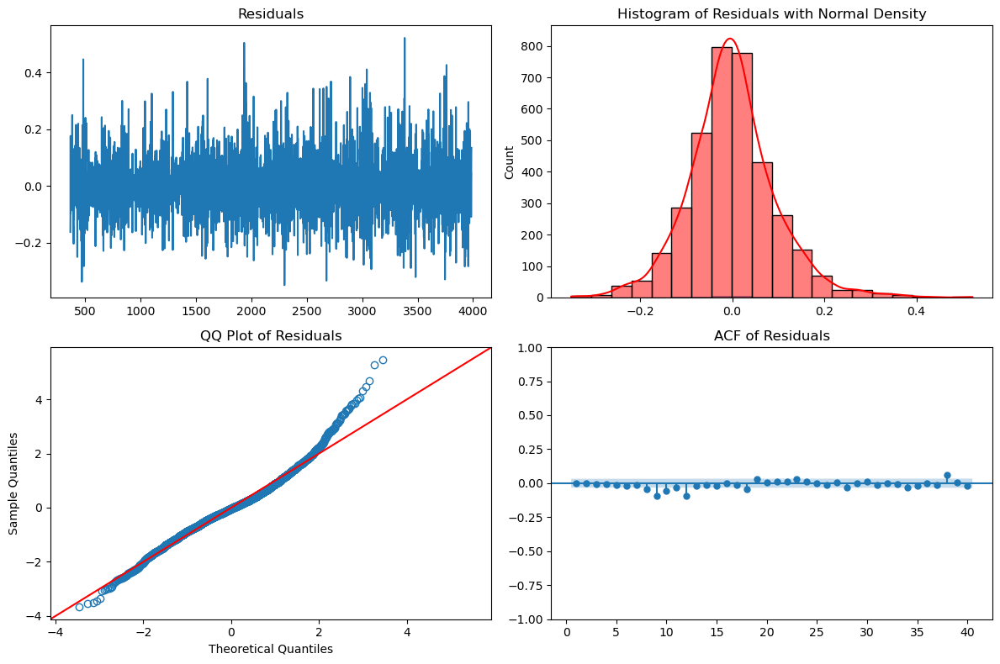

In [201]:
model = ARIMA(diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'], order=(6,0,0))
ARMA_res = model.fit()

# Extraire les résidus du modèle ARIMA
arima_residuals_ar_6= ARMA_res.resid

# Visualiser les diagnostics personnalisés
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Graphique des résidus
axes[0, 0].plot(arima_residuals_ar_6)
axes[0, 0].set_title('Residuals')

# Histogramme des résidus
axes[0, 1].hist(arima_residuals_ar_6, bins=20, density=True, alpha=0.7)
axes[0, 1].set_title('Histogram of Residuals')

# QQ plot des résidus
sm.qqplot(arima_residuals_ar_6.dropna(), norm,fit=True, line="45", marker='o', markerfacecolor='none',ax=axes[1, 0])
axes[1, 0].set_title('QQ Plot of Residuals')


# ACF des résidus
sm.graphics.tsa.plot_acf(arima_residuals_ar_6.dropna(), lags=40, zero=False, ax=axes[1, 1])
axes[1, 1].set_title('ACF of Residuals')

sns.histplot(arima_residuals_ar_6, bins=20, kde=True, ax=axes[0, 1], color='red')
axes[0, 1].set_title('Histogram of Residuals with Normal Density')


plt.tight_layout()
plt.show()

In [202]:
tester_durbin_watson(arima_residuals_ar_6.dropna())

Statistique de test Durbin-Watson : 1.9981967345102183
Pas d'autocorrélation détectée.


# AR (12)

                                           SARIMAX Results                                            
Dep. Variable:     Consommation brute gaz totale (MW PCS 0°C)   No. Observations:                 3189
Model:                                        ARIMA(12, 0, 0)   Log Likelihood                2736.000
Date:                                        Sun, 17 Dec 2023   AIC                          -5444.000
Time:                                                09:42:13   BIC                          -5359.055
Sample:                                                     0   HQIC                         -5413.540
                                                       - 3189                                         
Covariance Type:                                          opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.0

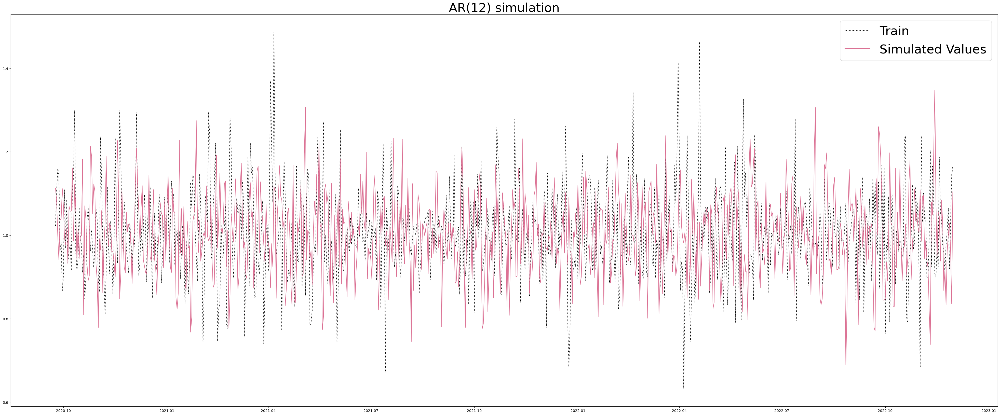

RMSE: 0.1474777767318259
MAE: 0.11628043823686028


In [203]:
###### AR(12)

import statsmodels.api as sm
import matplotlib.pyplot as plt

# Spécifie l'ordre AR à 6
order = (12, 0, 0)

# Remplacez par votre propre série temporelle
data = diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)']

# Séparer les données en ensembles d'entraînement (80%) et de test (20%)
train_size_ar12 = int(len(data) * 0.8)
train_ar12, test_ar12 = data[:train_size_ar12], data[train_size_ar12:]

# Entraîner le modèle MA sur les données d'entraînement
model = sm.tsa.ARIMA(train_ar12, order=order)
result = model.fit()

# Afficher les résultats du modèle
print(result.summary())

# Simuler les valeurs pour les données de test
simulated_values_ar12 = result.simulate(steps=len(test_ar12), nsimulations=len(test_ar12))

# Ajuster les index des valeurs simulées pour les faire correspondre aux données de test
simulated_values_ar12.index += len(train_ar12)

# Tracer les résultats
plt.figure(figsize=(50,20))
plt.plot(diff2_Dgj_exp ['Date'][train_size_ar12:], test_ar12, label='Train', linestyle='dotted', color='black')
plt.plot(diff2_Dgj_exp ['Date'][train_size_ar12:], simulated_values_ar12, label='Simulated Values', color='palevioletred')
plt.legend(fontsize=35)
plt.title('AR(12) simulation', fontsize=35)
plt.show()

##############

from sklearn.metrics import mean_squared_error, mean_absolute_error

# Calculer les prédictions sur les données de test
predictions = simulated_values_ar12

# Calculer l'erreur quadratique moyenne (RMSE)
rmse = np.sqrt(mean_squared_error(test_ar12, predictions))

# Calculer l'erreur absolue moyenne (MAE)
mae = mean_absolute_error(test_ar12, predictions)

print(f'RMSE: {rmse}')
print(f'MAE: {mae}')



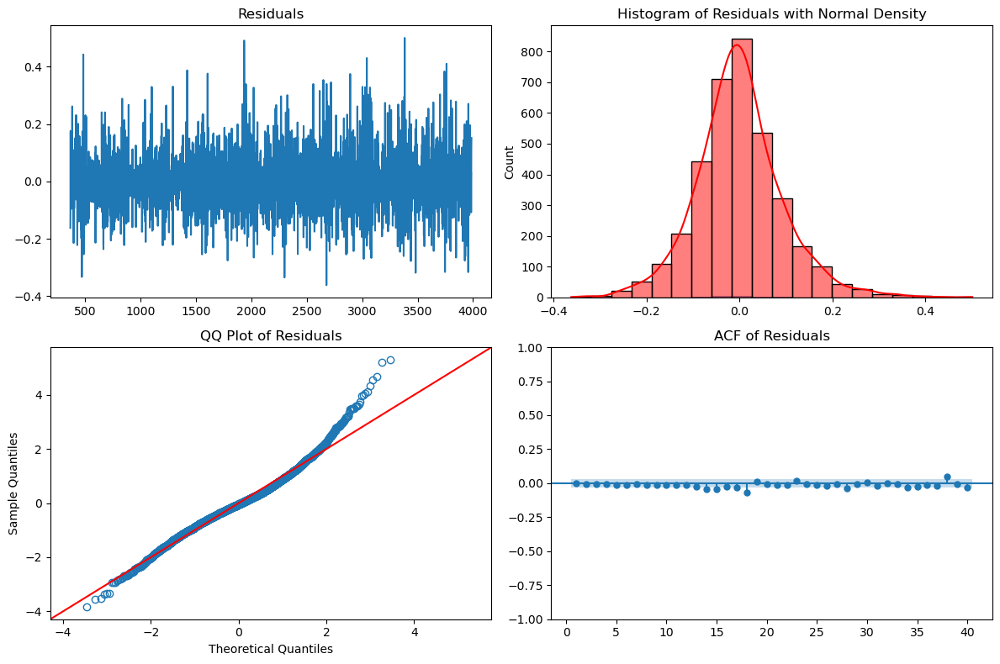

In [204]:
import seaborn as sns
from scipy.stats import norm

model = ARIMA(diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'], order=(12,0,0))
ARMA_res = model.fit()

# Extraire les résidus du modèle ARIMA
arima_residuals_ar_12 = ARMA_res.resid

# Visualiser les diagnostics personnalisés
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Graphique des résidus
axes[0, 0].plot(arima_residuals_ar_12)
axes[0, 0].set_title('Residuals')

# Histogramme des résidus
axes[0, 1].hist(arima_residuals_ar_12, bins=20, density=True, alpha=0.7)
axes[0, 1].set_title('Histogram of Residuals')

# QQ plot des résidus
sm.qqplot(arima_residuals_ar_12.dropna(), norm,fit=True, line="45", marker='o', markerfacecolor='none',ax=axes[1, 0])
axes[1, 0].set_title('QQ Plot of Residuals')


# ACF des résidus
sm.graphics.tsa.plot_pacf(arima_residuals_ar_12.dropna(), lags=40, zero=False, ax=axes[1, 1])
axes[1, 1].set_title('ACF of Residuals')

sns.histplot(arima_residuals_ar_12, bins=20, kde=True, ax=axes[0, 1], color='red')
axes[0, 1].set_title('Histogram of Residuals with Normal Density')


plt.tight_layout()
plt.show()


In [205]:
tester_durbin_watson(arima_residuals_ar_12.dropna())

Statistique de test Durbin-Watson : 2.0028059801700873
Pas d'autocorrélation détectée.


# Test de arma avec p=6 ou 12 et q=6 ou 12

                                           SARIMAX Results                                            
Dep. Variable:     Consommation brute gaz totale (MW PCS 0°C)   No. Observations:                 3189
Model:                                         ARIMA(6, 0, 6)   Log Likelihood                2737.204
Date:                                        Sun, 17 Dec 2023   AIC                          -5446.409
Time:                                                09:42:25   BIC                          -5361.464
Sample:                                                     0   HQIC                         -5415.949
                                                       - 3189                                         
Covariance Type:                                          opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.0

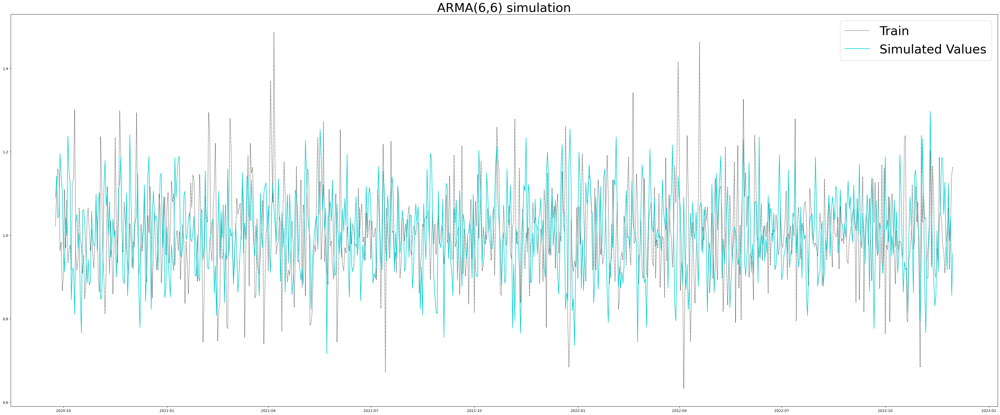

RMSE: 0.14415483576453977
MAE: 0.11318572756723995


In [206]:
###### ARMA(6,6)

import statsmodels.api as sm
import matplotlib.pyplot as plt

# Spécifie l'ordre AR à 6
order = (6, 0, 6)

# Remplacez par votre propre série temporelle
data = diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)']

# Séparer les données en ensembles d'entraînement (80%) et de test (20%)
train_size_arma_6_6 = int(len(data) * 0.8)
train_arma_6_6, test_arma_6_6 = data[:train_size_arma_6_6], data[train_size_arma_6_6:]

# Entraîner le modèle MA sur les données d'entraînement
model = sm.tsa.ARIMA(train_arma_6_6, order=order)
result = model.fit()

# Afficher les résultats du modèle
print(result.summary())

# Simuler les valeurs pour les données de test
simulated_values_arma_6_6 = result.simulate(steps=len(test_arma_6_6), nsimulations=len(test_arma_6_6))

# Ajuster les index des valeurs simulées pour les faire correspondre aux données de test
simulated_values_arma_6_6.index += len(train_arma_6_6)

# Tracer les résultats
plt.figure(figsize=(50,20))
plt.plot(diff2_Dgj_exp ['Date'][train_size_arma_6_6:], test_arma_6_6, label='Train', linestyle='dotted', color='black')
plt.plot(diff2_Dgj_exp ['Date'][train_size_arma_6_6:], simulated_values_arma_6_6, label='Simulated Values', color='darkturquoise')
plt.legend(fontsize=35)
plt.title('ARMA(6,6) simulation', fontsize=35)
plt.show()

##############

from sklearn.metrics import mean_squared_error, mean_absolute_error

# Calculer les prédictions sur les données de test
predictions = simulated_values_arma_6_6

# Calculer l'erreur quadratique moyenne (RMSE)
rmse = np.sqrt(mean_squared_error(test_arma_6_6, predictions))

# Calculer l'erreur absolue moyenne (MAE)
mae = mean_absolute_error(test_arma_6_6, predictions)

print(f'RMSE: {rmse}')
print(f'MAE: {mae}')



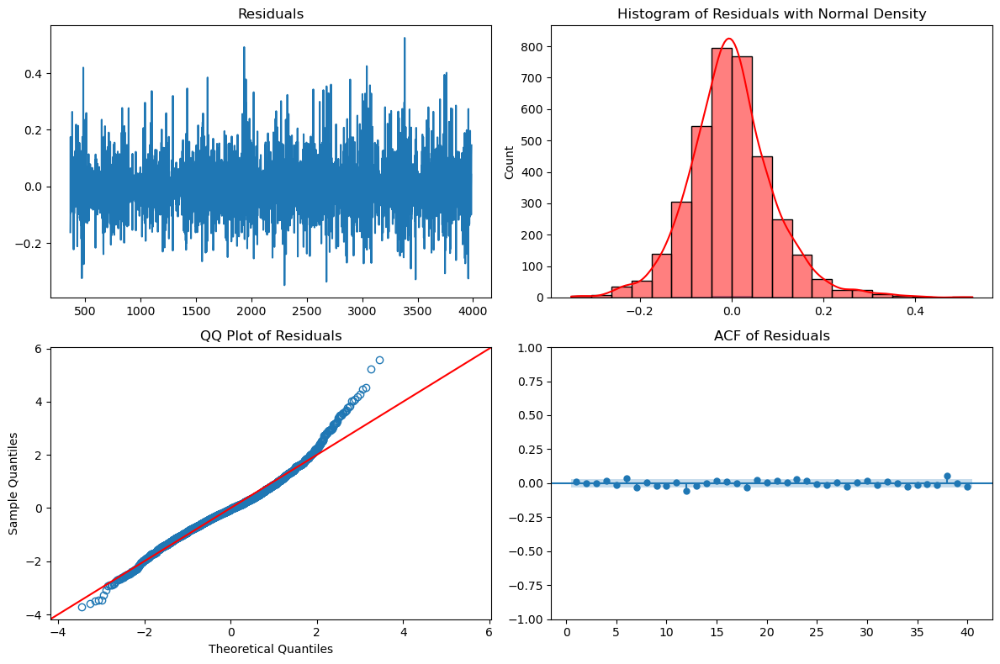

In [207]:
import seaborn as sns
from scipy.stats import norm

model = ARIMA(diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'], order=(6,0,6))
ARMA_res = model.fit()

# Extraire les résidus du modèle ARIMA
arima_residuals6_6 = ARMA_res.resid

# Visualiser les diagnostics personnalisés
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Graphique des résidus
axes[0, 0].plot(arima_residuals6_6)
axes[0, 0].set_title('Residuals')

# Histogramme des résidus
axes[0, 1].hist(arima_residuals6_6, bins=20, density=True, alpha=0.7)
axes[0, 1].set_title('Histogram of Residuals')

# QQ plot des résidus
sm.qqplot(arima_residuals6_6.dropna(), norm,fit=True, line="45", marker='o', markerfacecolor='none',ax=axes[1, 0])
axes[1, 0].set_title('QQ Plot of Residuals')


# ACF des résidus
sm.graphics.tsa.plot_pacf(arima_residuals6_6.dropna(), lags=40, zero=False, ax=axes[1, 1])
axes[1, 1].set_title('ACF of Residuals')

sns.histplot(arima_residuals6_6, bins=20, kde=True, ax=axes[0, 1], color='red')
axes[0, 1].set_title('Histogram of Residuals with Normal Density')


plt.tight_layout()
plt.show()


In [208]:
tester_durbin_watson(arima_residuals6_6.dropna())

Statistique de test Durbin-Watson : 1.977398138172324
Pas d'autocorrélation détectée.


                                           SARIMAX Results                                            
Dep. Variable:     Consommation brute gaz totale (MW PCS 0°C)   No. Observations:                 3189
Model:                                       ARIMA(12, 0, 12)   Log Likelihood                2759.690
Date:                                        Sun, 17 Dec 2023   AIC                          -5467.380
Time:                                                09:42:51   BIC                          -5309.626
Sample:                                                     0   HQIC                         -5410.813
                                                       - 3189                                         
Covariance Type:                                          opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.0

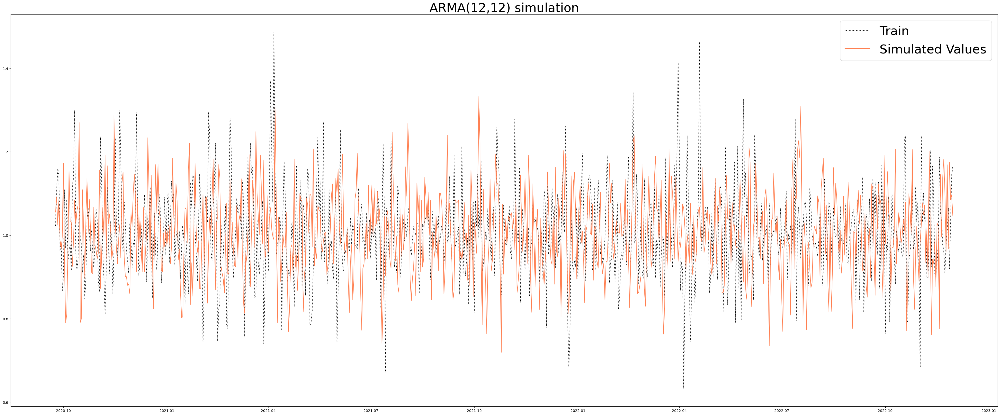

RMSE: 0.14682978955251358
MAE: 0.1156868639697041


In [209]:
###### ARMA(12,12)

import statsmodels.api as sm
import matplotlib.pyplot as plt

# Spécifie l'ordre AR à 6
order = (12, 0, 12)

# Remplacez par votre propre série temporelle
data = diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)']

# Séparer les données en ensembles d'entraînement (80%) et de test (20%)
train_size_arma_12_12 = int(len(data) * 0.8)
train_arma_12_12, test_arma_12_12 = data[:train_size_arma_12_12], data[train_size_arma_12_12:]

# Entraîner le modèle MA sur les données d'entraînement
model = sm.tsa.ARIMA(train_arma_12_12, order=order)
result = model.fit()

# Afficher les résultats du modèle
print(result.summary())

# Simuler les valeurs pour les données de test
simulated_values_arma_12_12 = result.simulate(steps=len(test_arma_12_12), nsimulations=len(test_arma_12_12))

# Ajuster les index des valeurs simulées pour les faire correspondre aux données de test
simulated_values_arma_12_12.index += len(train_arma_12_12)

# Tracer les résultats
plt.figure(figsize=(50,20))
plt.plot(diff2_Dgj_exp ['Date'][train_size_arma_12_12:],test_arma_12_12 , label='Train', linestyle='dotted',color='black')
plt.plot(diff2_Dgj_exp ['Date'][train_size_arma_12_12:], simulated_values_arma_12_12, label='Simulated Values',color='coral')
plt.legend(fontsize=35)
plt.title('ARMA(12,12) simulation', fontsize=35)
plt.show()

##############

from sklearn.metrics import mean_squared_error, mean_absolute_error

# Calculer les prédictions sur les données de test
predictions = simulated_values_arma_12_12

# Calculer l'erreur quadratique moyenne (RMSE)
rmse = np.sqrt(mean_squared_error(test_arma_12_12, predictions))

# Calculer l'erreur absolue moyenne (MAE)
mae = mean_absolute_error(test_arma_12_12, predictions)

print(f'RMSE: {rmse}')
print(f'MAE: {mae}')



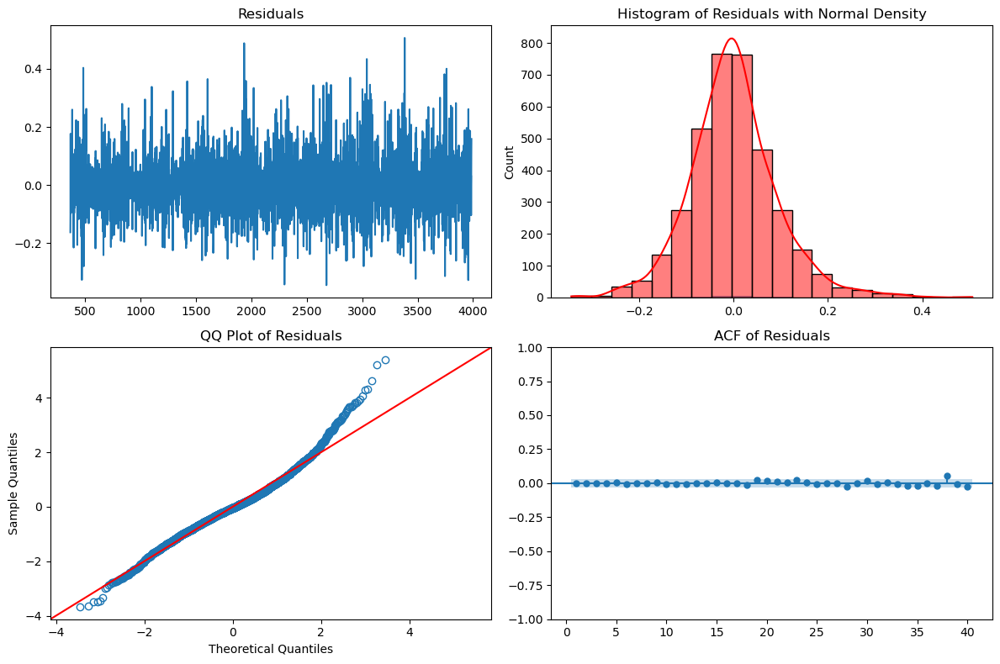

In [210]:
model = ARIMA(diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'], order=(12,0,12))
ARMA_res = model.fit()

# Extraire les résidus du modèle ARIMA
arima_residuals12_12 = ARMA_res.resid

# Visualiser les diagnostics personnalisés
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Graphique des résidus
axes[0, 0].plot(arima_residuals12_12)
axes[0, 0].set_title('Residuals')

# Histogramme des résidus
axes[0, 1].hist(arima_residuals12_12, bins=20, density=True, alpha=0.7)
axes[0, 1].set_title('Histogram of Residuals')

# QQ plot des résidus
sm.qqplot(arima_residuals12_12.dropna(), norm,fit=True, line="45", marker='o', markerfacecolor='none',ax=axes[1, 0])
axes[1, 0].set_title('QQ Plot of Residuals')


# ACF des résidus
sm.graphics.tsa.plot_pacf(arima_residuals12_12.dropna(), lags=40, zero=False, ax=axes[1, 1])
axes[1, 1].set_title('ACF of Residuals')

sns.histplot(arima_residuals12_12, bins=20, kde=True, ax=axes[0, 1], color='red')
axes[0, 1].set_title('Histogram of Residuals with Normal Density')


plt.tight_layout()
plt.show()


In [211]:
tester_durbin_watson(arima_residuals12_12.dropna())

Statistique de test Durbin-Watson : 1.999287580171414
Pas d'autocorrélation détectée.


                                           SARIMAX Results                                            
Dep. Variable:     Consommation brute gaz totale (MW PCS 0°C)   No. Observations:                 3189
Model:                                        ARIMA(6, 0, 12)   Log Likelihood                2757.639
Date:                                        Sun, 17 Dec 2023   AIC                          -5475.279
Time:                                                09:43:24   BIC                          -5353.929
Sample:                                                     0   HQIC                         -5431.765
                                                       - 3189                                         
Covariance Type:                                          opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.0

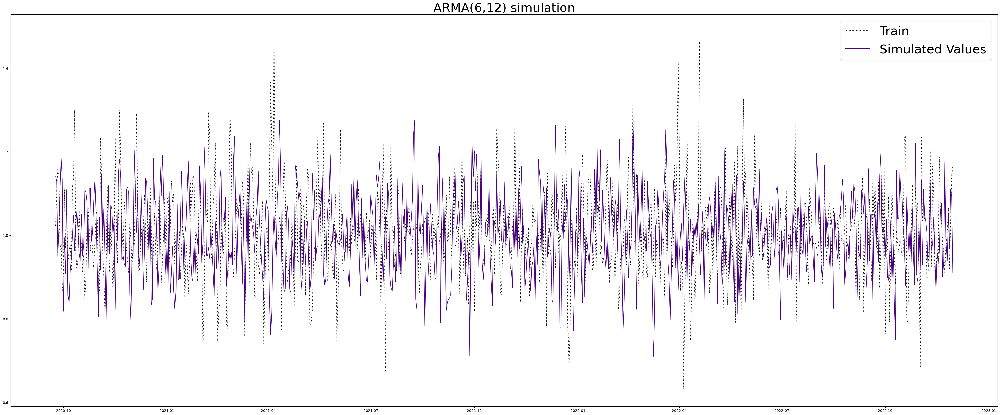

RMSE: 0.14774227097432874
MAE: 0.11646409461572763


In [212]:
###### ARMA(6,12)

import statsmodels.api as sm
import matplotlib.pyplot as plt

# Spécifie l'ordre AR à 6
order = (6, 0, 12)

# Remplacez par votre propre série temporelle
data = diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)']

# Séparer les données en ensembles d'entraînement (80%) et de test (20%)
train_size_arma_6_12 = int(len(data) * 0.8)
train_arma_6_12, test_arma_6_12 = data[:train_size_arma_6_12], data[train_size_arma_6_12:]

# Entraîner le modèle MA sur les données d'entraînement
model = sm.tsa.ARIMA(train_arma_6_12, order=order)
result = model.fit()

# Afficher les résultats du modèle
print(result.summary())

# Simuler les valeurs pour les données de test
simulated_values_arma_6_12 = result.simulate(steps=len(test_arma_6_12), nsimulations=len(test_arma_6_12))

# Ajuster les index des valeurs simulées pour les faire correspondre aux données de test
simulated_values_arma_6_12.index += len(train_arma_6_12)

# Tracer les résultats
plt.figure(figsize=(50,20))
plt.plot(diff2_Dgj_exp ['Date'][train_size_arma_6_12:], test_arma_6_12, label='Train',linestyle='dotted', color='black')
plt.plot(diff2_Dgj_exp ['Date'][train_size_arma_6_12:], simulated_values_arma_6_12, label='Simulated Values', color='indigo')
plt.legend(fontsize=35)
plt.title('ARMA(6,12) simulation', fontsize=35)
plt.show()

##############

from sklearn.metrics import mean_squared_error, mean_absolute_error

# Calculer les prédictions sur les données de test
predictions = simulated_values_arma_6_12

# Calculer l'erreur quadratique moyenne (RMSE)
rmse = np.sqrt(mean_squared_error(test_arma_6_12, predictions))

# Calculer l'erreur absolue moyenne (MAE)
mae = mean_absolute_error(test_arma_6_12, predictions)

print(f'RMSE: {rmse}')
print(f'MAE: {mae}')



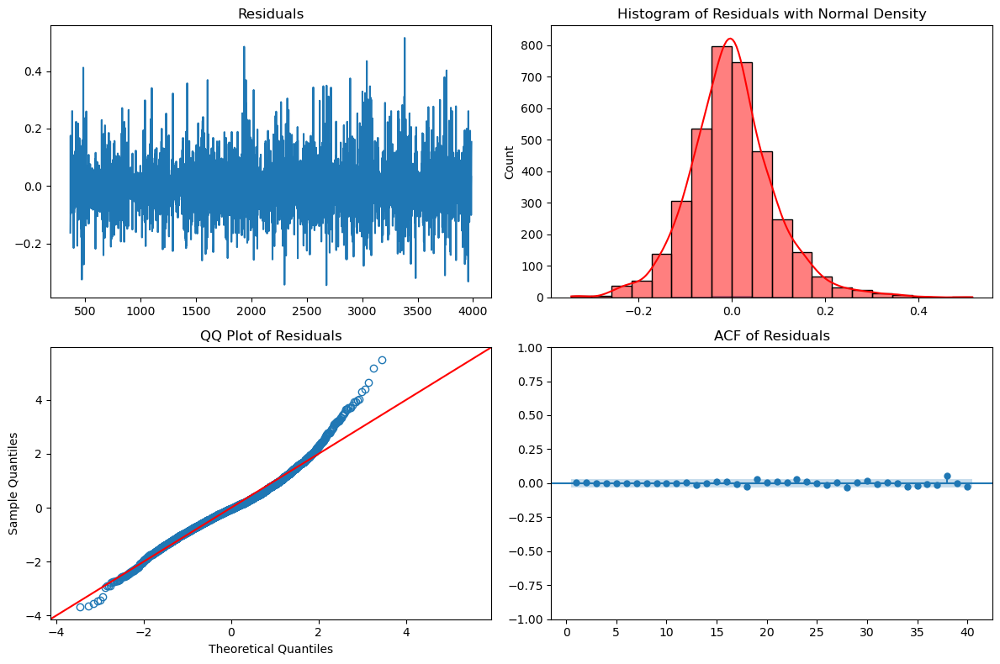

In [213]:
import seaborn as sns
from scipy.stats import norm

model = ARIMA(diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'], order=(6,0,12))
ARMA_res = model.fit()

# Extraire les résidus du modèle ARIMA
arima_residuals6_12 = ARMA_res.resid

# Visualiser les diagnostics personnalisés
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Graphique des résidus
axes[0, 0].plot(arima_residuals6_12)
axes[0, 0].set_title('Residuals')

# Histogramme des résidus
axes[0, 1].hist(arima_residuals6_12, bins=20, density=True, alpha=0.7)
axes[0, 1].set_title('Histogram of Residuals')

# QQ plot des résidus
sm.qqplot(arima_residuals6_12.dropna(), norm,fit=True, line="45", marker='o', markerfacecolor='none',ax=axes[1, 0])
axes[1, 0].set_title('QQ Plot of Residuals')


# ACF des résidus
sm.graphics.tsa.plot_pacf(arima_residuals6_12.dropna(), lags=40, zero=False, ax=axes[1, 1])
axes[1, 1].set_title('ACF of Residuals')

sns.histplot(arima_residuals6_12, bins=20, kde=True, ax=axes[0, 1], color='red')
axes[0, 1].set_title('Histogram of Residuals with Normal Density')


plt.tight_layout()
plt.show()


In [214]:
tester_durbin_watson(arima_residuals6_12.dropna())

Statistique de test Durbin-Watson : 1.9922612968892564
Pas d'autocorrélation détectée.


                                           SARIMAX Results                                            
Dep. Variable:     Consommation brute gaz totale (MW PCS 0°C)   No. Observations:                 3189
Model:                                        ARIMA(12, 0, 6)   Log Likelihood                2753.159
Date:                                        Sun, 17 Dec 2023   AIC                          -5466.319
Time:                                                09:43:50   BIC                          -5344.970
Sample:                                                     0   HQIC                         -5422.805
                                                       - 3189                                         
Covariance Type:                                          opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.0

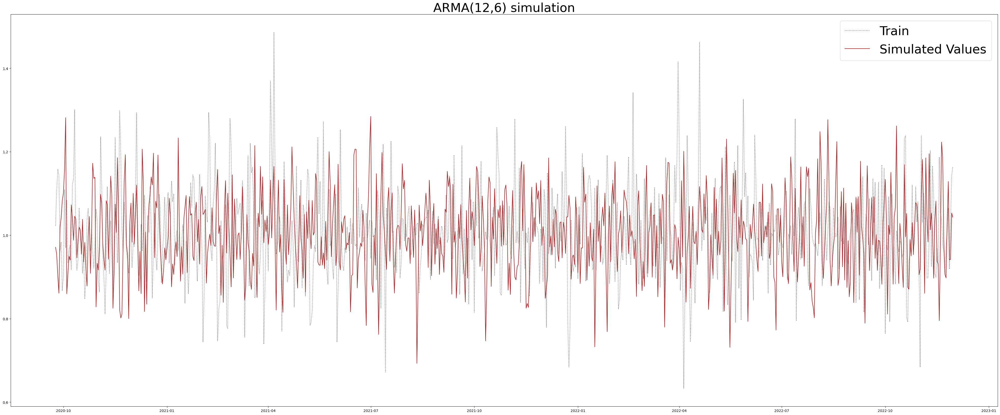

RMSE: 0.14625317631589457
MAE: 0.11577096971268186


In [215]:
###### ARMA(12,6)

import statsmodels.api as sm
import matplotlib.pyplot as plt

# Spécifie l'ordre AR à 6
order = (12, 0, 6)

# Remplacez par votre propre série temporelle
data = diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)']

# Séparer les données en ensembles d'entraînement (80%) et de test (20%)
train_size_arma_12_6 = int(len(data) * 0.8)
train_arma_12_6, test_arma_12_6 = data[:train_size_arma_12_6], data[train_size_arma_12_6:]

# Entraîner le modèle MA sur les données d'entraînement
model = sm.tsa.ARIMA(train_arma_12_6, order=order)
result = model.fit()

# Afficher les résultats du modèle
print(result.summary())

# Simuler les valeurs pour les données de test
simulated_values_arma_12_6 = result.simulate(steps=len(test_arma_12_6), nsimulations=len(test_arma_12_6))

# Ajuster les index des valeurs simulées pour les faire correspondre aux données de test
simulated_values_arma_12_6.index += len(train_arma_12_6)

# Tracer les résultats
plt.figure(figsize=(50,20))
plt.plot(diff2_Dgj_exp ['Date'][train_size_arma_12_6:],test_arma_12_6 , label='Train', linestyle='dotted',linewidth=1.5, color='dimgray')
plt.plot(diff2_Dgj_exp ['Date'][train_size_arma_12_6:], simulated_values_arma_12_6, label='Simulated Values', color='firebrick')
plt.legend(fontsize=35)
plt.title('ARMA(12,6) simulation', fontsize=35)
plt.show()

##############

from sklearn.metrics import mean_squared_error, mean_absolute_error

# Calculer les prédictions sur les données de test
predictions = simulated_values_arma_12_6

# Calculer l'erreur quadratique moyenne (RMSE)
rmse = np.sqrt(mean_squared_error(test_arma_12_6, predictions))

# Calculer l'erreur absolue moyenne (MAE)
mae = mean_absolute_error(test_arma_12_6, predictions)

print(f'RMSE: {rmse}')
print(f'MAE: {mae}')



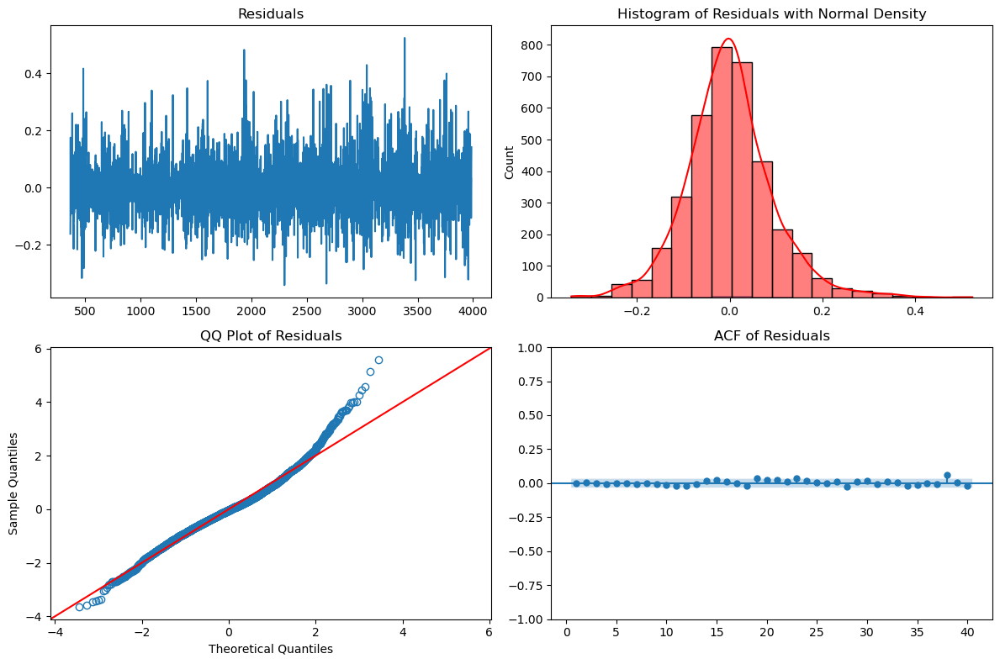

In [216]:
model = ARIMA(diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'], order=(12,0,6))
ARMA_res = model.fit()

# Extraire les résidus du modèle ARIMA
arima_residuals12_6 = ARMA_res.resid

# Visualiser les diagnostics personnalisés
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Graphique des résidus
axes[0, 0].plot(arima_residuals12_6)
axes[0, 0].set_title('Residuals')

# Histogramme des résidus
axes[0, 1].hist(arima_residuals12_6, bins=20, density=True, alpha=0.7)
axes[0, 1].set_title('Histogram of Residuals')

# QQ plot des résidus
sm.qqplot(arima_residuals12_6.dropna(), norm,fit=True, line="45", marker='o', markerfacecolor='none',ax=axes[1, 0])
axes[1, 0].set_title('QQ Plot of Residuals')


# ACF des résidus
sm.graphics.tsa.plot_acf(arima_residuals12_6.dropna(), lags=40, zero=False, ax=axes[1, 1])
axes[1, 1].set_title('ACF of Residuals')

sns.histplot(arima_residuals12_6, bins=20, kde=True, ax=axes[0, 1], color='red')
axes[0, 1].set_title('Histogram of Residuals with Normal Density')


plt.tight_layout()
plt.show()


In [104]:
tester_durbin_watson(arima_residuals12_6.dropna())

Statistique de test Durbin-Watson : 1.9971369492791178
Pas d'autocorrélation détectée.


DW=sum(Zt-Zt-1)^2/Zt^2 ou Zt correpond au residu de notre modele de prediction


Si la statistique de test Durbin-Watson (DW) est proche de 2, cela suggère qu'il n'y a pas d'autocorrélation significative dans les résidus du modèle AR.
Si DW est significativement inférieur à 2, cela suggère une autocorrélation positive dans les résidus.
Si DW est significativement supérieur à 2, cela suggère une autocorrélation négative dans les résidus


le test de Durbin-Watson peut être appliqué pour évaluer la présence d'autocorrélation dans les résidus, que le modèle soit AR, MA (moyenne mobile), ou ARMA (autoregressive moving average). Cela fournit une indication de la validité du modèle et peut orienter les ajustements nécessaires pour améliorer la spécification du modèle.

# ARMA 

In [109]:

# Définir les ordres p et q pour les modèles ARMA
p_values = np.arange(1,12)
q_values = np.arange(1,6)

# Initialiser une liste pour stocker les résultats
results = []

# Boucle à travers les combinaisons d'ordres p et q
for p in p_values:
    for q in q_values:
        try:
            # Ajuster le modèle ARMA
            model = sm.tsa.ARIMA(diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'], order=(p,0, q))
            result = model.fit()

            # Enregistrer les résultats (AIC et autres métriques si nécessaire)
            results.append({'Order': (p,0,q), 'AIC': result.aic})

        except Exception as e:
            # Gérer les erreurs éventuelles lors de l'ajustement du modèle
            print(f"ARMA({p},{q}) a échoué : {e}")

# Créer un DataFrame à partir des résultats
results_df = pd.DataFrame(results)

# Trouver le modèle avec le plus petit AIC
best_model = results_df.loc[results_df['AIC'].idxmin()]

# Imprimer les résultats
print("Meilleur modèle (ordre p, q) :", best_model['Order'])
print("AIC correspondant :", best_model['AIC'])

Meilleur modèle (ordre p, q) : (11, 0, 3)
AIC correspondant : -6830.003043355977


                                           SARIMAX Results                                            
Dep. Variable:     Consommation brute gaz totale (MW PCS 0°C)   No. Observations:                 3189
Model:                                        ARIMA(11, 0, 3)   Log Likelihood                2750.215
Date:                                        Sun, 17 Dec 2023   AIC                          -5468.429
Time:                                                09:44:14   BIC                          -5371.350
Sample:                                                     0   HQIC                         -5433.618
                                                       - 3189                                         
Covariance Type:                                          opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.0

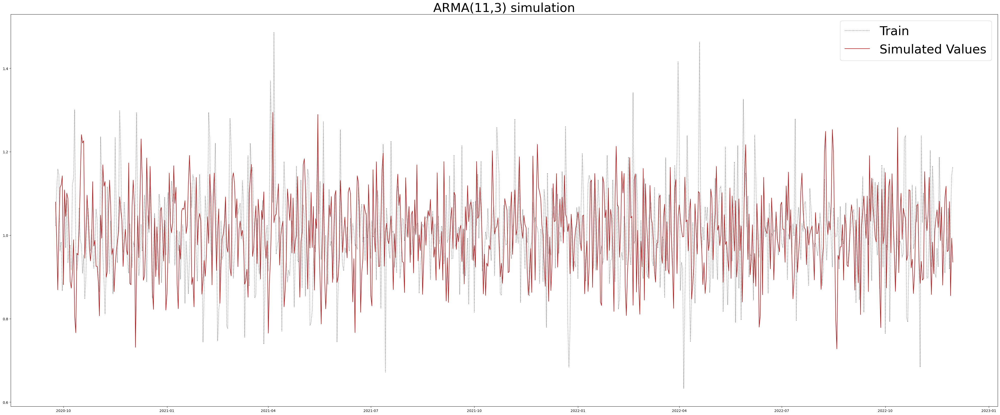

RMSE: 0.14058643047891906
MAE: 0.11062635139992563


In [217]:
import statsmodels.api as sm
import matplotlib.pyplot as plt

# Spécifie l'ordre AR à 6
order = (11, 0, 3)

# Remplacez par votre propre série temporelle
data = diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)']

# Séparer les données en ensembles d'entraînement (80%) et de test (20%)
train_size_arma_11_3 = int(len(data) * 0.8)
train_arma_11_3, test_arma_11_3 = data[:train_size_arma_11_3], data[train_size_arma_11_3:]

# Entraîner le modèle MA sur les données d'entraînement
model = sm.tsa.ARIMA(train_arma_11_3, order=order)
result = model.fit()

# Afficher les résultats du modèle
print(result.summary())

# Simuler les valeurs pour les données de test
simulated_values_arma_11_3 = result.simulate(steps=len(test_arma_11_3), nsimulations=len(test_arma_11_3))

# Ajuster les index des valeurs simulées pour les faire correspondre aux données de test
simulated_values_arma_11_3.index += len(train_arma_11_3)

# Tracer les résultats
plt.figure(figsize=(50,20))
plt.plot(diff2_Dgj_exp ['Date'][train_size_arma_11_3:],test_arma_11_3 , label='Train', linestyle='dotted',linewidth=1.5, color='dimgray')
plt.plot(diff2_Dgj_exp ['Date'][train_size_arma_11_3:], simulated_values_arma_11_3, label='Simulated Values', color='firebrick')
plt.legend(fontsize=35)
plt.title('ARMA(11,3) simulation', fontsize=35)
plt.show()

##############

from sklearn.metrics import mean_squared_error, mean_absolute_error

# Calculer les prédictions sur les données de test
predictions = simulated_values_arma_11_3

# Calculer l'erreur quadratique moyenne (RMSE)
rmse = np.sqrt(mean_squared_error(test_arma_11_3, predictions))

# Calculer l'erreur absolue moyenne (MAE)
mae = mean_absolute_error(test_arma_11_3, predictions)

print(f'RMSE: {rmse}')
print(f'MAE: {mae}')

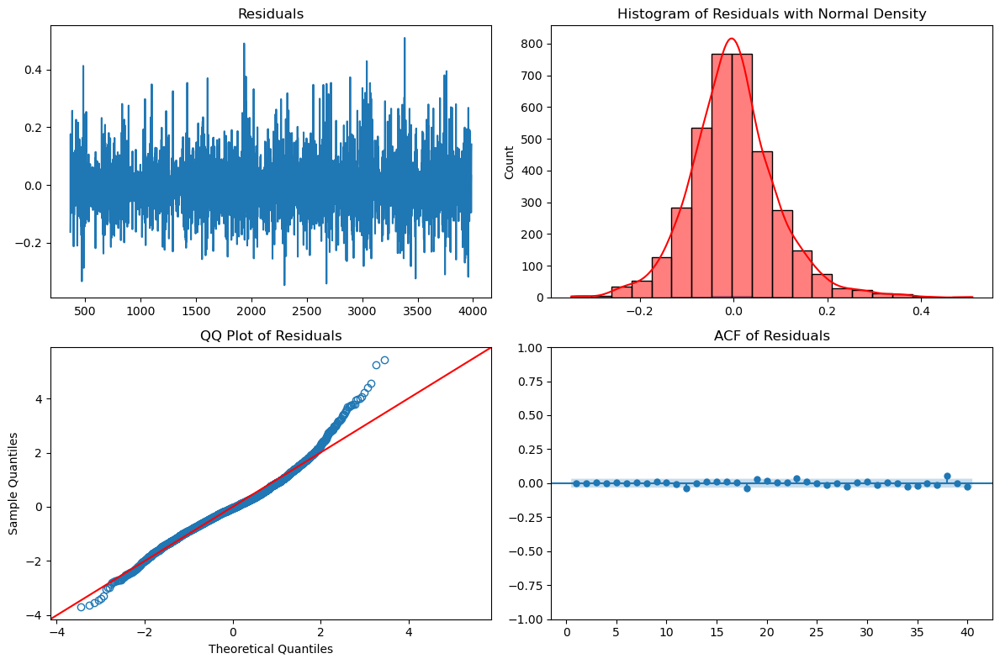

In [218]:

model = ARIMA(diff2_Dgj_exp['Consommation brute gaz totale (MW PCS 0°C)'], order=(11,0,3))
ARMA_res = model.fit()

# Extraire les résidus du modèle ARIMA
arima_residuals_11_3= ARMA_res.resid

# Visualiser les diagnostics personnalisés
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Graphique des résidus
axes[0, 0].plot(arima_residuals_11_3)
axes[0, 0].set_title('Residuals')

# Histogramme des résidus
axes[0, 1].hist(arima_residuals_11_3, bins=20, density=True, alpha=0.7)
axes[0, 1].set_title('Histogram of Residuals')

# QQ plot des résidus
sm.qqplot(arima_residuals_11_3.dropna(), norm,fit=True, line="45", marker='o', markerfacecolor='none',ax=axes[1, 0])
axes[1, 0].set_title('QQ Plot of Residuals')


# ACF des résidus
sm.graphics.tsa.plot_acf(arima_residuals_11_3.dropna(), lags=40, zero=False, ax=axes[1, 1])
axes[1, 1].set_title('ACF of Residuals')

sns.histplot(arima_residuals_11_3, bins=20, kde=True, ax=axes[0, 1], color='red')
axes[0, 1].set_title('Histogram of Residuals with Normal Density')


plt.tight_layout()
plt.show()

In [219]:
tester_durbin_watson(arima_residuals_11_3.dropna())

Statistique de test Durbin-Watson : 2.0032676152105595
Pas d'autocorrélation détectée.


In [220]:
arima_residuals_11_3.mean()

-0.00018600296602835475

# COMPARAISON AIC 

In [221]:
ARMA_res.aic

-6830.003043355977

In [222]:
model = sm.tsa.ARIMA(train_ar12, order=(12,0,0))
result_AR12 = model.fit()

result_AR12.aic

-5443.99965753198

In [223]:
model = sm.tsa.ARIMA(train_ma6, order=(0,0,6))
result_MA6 = model.fit()

result_MA6.aic

-5430.220510723172

# PREDICTION SUR LES DONNEES ORIGINALES

In [228]:
R=Dgj_log['Consommation brute gaz totale (MW PCS 0°C)']-diff2_Dgj_log['Consommation brute gaz totale (MW PCS 0°C)'] 

# Étape inverse Effectuer l'opération inverse des différenciations         
simulated_ori=np.log(simulated_values_arma_11_3)          
simulated_ori= simulated_ori.diff(1).cumsum().diff(364).cumsum()
simulated_ori=simulated_ori+R


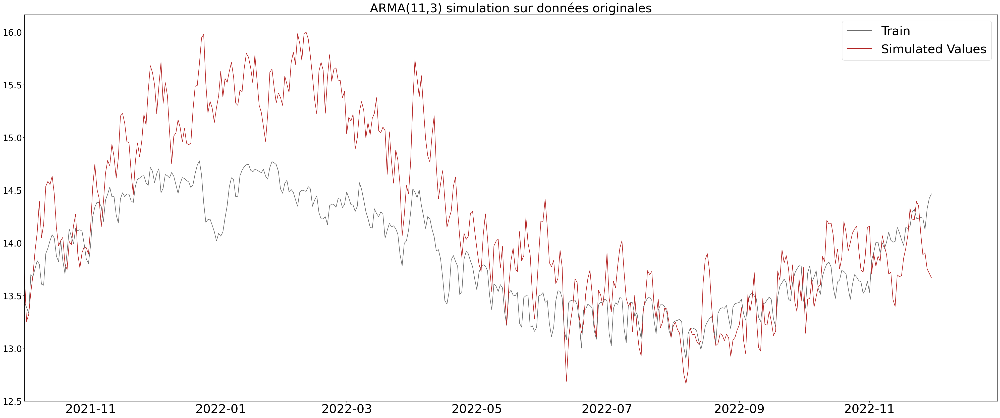

In [229]:


plt.figure(figsize=(50,20))

plt.plot(Dgj_log['Date'],Dgj_log['Consommation brute gaz totale (MW PCS 0°C)'] , label='Train',linewidth=1.5, color='dimgray')
plt.plot(Dgj_log['Date'], simulated_ori, label='Simulated Values', color='firebrick')

plt.xlim(pd.Timestamp('2021-10-01'), pd.Timestamp('2022-12-31'))
plt.legend(fontsize=35)
plt.xticks(fontsize=35)
plt.yticks(fontsize=25)

plt.title('ARMA(11,3) simulation sur données originales', fontsize=35)
plt.show()

In [230]:
# Calculer l'erreur quadratique moyenne (RMSE)
rmse = np.sqrt(mean_squared_error(Dgj_log['Consommation brute gaz totale (MW PCS 0°C)'][3554:], simulated_ori.dropna()))

print(f'RMSE: {rmse}')


RMSE: 0.6124234114487271


In [227]:
len(Dgj_log)-len(simulated_ori.dropna())

3554